## Introduction

There is a general concensus that fire services, a frontline service, is one of the various crucial aid organizations neccessary for civillian and environmental safety. As a integral part of the emergency 911 services in Ontario, the fire department is dispatched along with police and ambulance for the majority of emergency calls. For example, in 2021, fire services responded to 133,533 emergencies in Toronto, one of Canada’s largest cities. Although fire services are a neccessary service to have on high alert at all times, high activity of these services can be a cause for concern. It might be important to dig deeper into why? It can provide a prevalence indication and highlight insights around what causes frequent fire-related emergencies. Evaluating and highlighting fire incidents’ insights will not only identify common determinants of the incidents but also provide awareness in the dangers of fire causing activities and improvements in the role fire services play to better manage these issues. 

Data visualization has been an effective technique in making data comprehension easier. It allows one to peice together a comprehensive story or patterns on what the data is indicating on a deeper level. We can find insights that one would not be able to formulate from looking at various extensive sets of data alone. Exploring visualizations of the data on Toronto fire incidents can help us better gather multi-factor determinants of common fire issues, correlations between causes of fire and other factors, impacts such as the kind of loss, damage and costs that arise from them, and patterns in responder interactions within these incidents. The insights gathered from these data points
can reinforce existing strategies and help come up with more effective ones for fire services and residents to reduce the risk of fire related emergencies. 

I specifically chose the Toronto Fire Incidents dataset from Kaggle, because we are seeing a rise in fire emergencies in city, especially over the pandemic. Toronto is also the city I live in and was raised in so I'm interested to see data patterns for the city I am from and understand the patterns that occur in this sibject matter since I am surrounded by those events. 

The data exploration will attempt to answer the following questions: 

• What are the areas of origin where fires most occur?
• What are the top determinants (probable cause) of residential fire in Toronto over the last 9 years?
• When do casualties most occur? Correlations between casualties and other factors 
• Which areas receive the most fire emergency calls?


Casualties most often occur in the cooking and sleeping area’s.
Fires that spread more often result in casualties.
Evacuating people can result in more casualties.
Casualties most often occur when improperly handling cooking oil, cabinetry, bedding and mattresses/pillows.
Casualties occur more often when people try to put out the fire themselves, automatic systems are safest.
Casualties occur more often in multi-unit properties.
Risk increases when fire alarms are installed but do not work due to batteries, improper installation etc..
Battery operated fire alarms are more dangerous than other types.

## Data Description 
The "Toronto Fire Indicent" dataset from Kaggle consists of 27 columns, over 11,000 rows, highlighting the specifications of each fire incident that occured and was attended to by the toronto fire departments from the years 2011-2018 


Area_of_Origin - Categorical   
Business_Impact - Categorical   
Civilian_Casualties - Numeric (Continuous)  
Count_of_Persons_Rescued - Numeric (Continuous)  
Estimated_Dollar_Loss - - Numeric (Continuous)    
Estimated_Number_Of_Persons_Displaced - Numeric (Continuous)  
Ext_agent_app_or_defer_time  - Numeric (Timestamp)   
Extent_Of_Fire - Categorical   
Fire_Alarm_System_Impact_on_Evacuation - Categorical   
Fire_Alarm_System_Operation - Categorical   
Fire_Alarm_System_Presence - Categorical   
Fire_Under_Control_Time - Numeric (Timestamp)   
Ignition_Source - Categorical   
Incident_Station_Area - Numeric (Discrete)   
Incident_Ward - Numeric (Discrete)   
Last_TFS_Unit_Clear_Time - Numeric (Timestamp)   
Latitude - Numeric (Location Coordinates)   
Longitude - Numeric (Location Coordinate)   
Material_First_Ignited - Categorical   
Method_Of_Fire_Control - Categorical   
Possible_Cause - Categorical   
Property_Use - Categorical   
Smoke_Alarm_at_Fire_Origin_Alarm_Failure - Categorical   
Smoke_Alarm_at_Fire_Origin_Alarm_Type - Categorical    
Status_of_Fire_On_Arrival - Categorical - Categorical    
TFS_Alarm_Time - Numeric (Timestamp)  
TFS_Arrival_Time - Numeric (Timestamp)


The data is a mix of catgorical and numeric data. I would pool all the data into three important categories:
Catgory 1: Fire Service Efficiency
Alarm time, arrival time, property use, dispatch personnel information. Most of this data fall under time series data (continuous numeric), and numerical discrete data.

Category 2: Fire Incident Details 
Regional data, coordinate data, data points describing the kind of fire, causes of
fire, items in the fire, etc. Most of these datapoints are text categorical datatypes.

Category 3: Human Impact and Overall Damage. 
Human elements such as casualties, number of people injured
and rescued, etc. Most of these data points are discrete or continuous numeric data types. 

For example, 

Civillian_Casualties, Count_of_Persons_Rescued, Estimated_Doller_Loss and Estimated_Number_of_persons_displaced are
all discrete numeric data types, whereas Area_of_Origin and Business_Impact are string categorical data.

## Data Pre-Processing

In [705]:
#imports
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import textwrap
import plotly.express as px
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", None)
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from matplotlib.pyplot import figure
import numpy as np
import folium

In [706]:
df_toronto_fire_orig = pd.read_csv('Fire-Incidents.csv')
df_toronto_fire_orig.head()
df = df_toronto_fire_orig.copy()
df.head()

,Area_of_Origin,Business_Impact,Civilian_Casualties,Count_of_Persons_Rescued,Estimated_Dollar_Loss,Estimated_Number_Of_Persons_Displaced,Ext_agent_app_or_defer_time,Extent_Of_Fire,Fire_Alarm_System_Impact_on_Evacuation,Fire_Alarm_System_Operation,Fire_Alarm_System_Presence,Fire_Under_Control_Time,Ignition_Source,Incident_Station_Area,Incident_Ward,Last_TFS_Unit_Clear_Time,Latitude,Longitude,Material_First_Ignited,Method_Of_Fire_Control,Possible_Cause,Property_Use,Smoke_Alarm_at_Fire_Origin_Alarm_Failure,Smoke_Alarm_at_Fire_Origin_Alarm_Type,Status_of_Fire_On_Arrival,TFS_Alarm_Time,TFS_Arrival_Time
0,Porch or Balcony,No business interruption,0,86,3000,0,2018-08-24T17:06:26,Confined to object of origin,Not applicable: Occupant(s) first alerted by o...,Fire alarm system did not operate,Fire alarm system present,2018-08-24T17:06:28,Undetermined,114,18.0,2018-08-24T17:42:43,43.760357,-79.412479,Undetermined (formerly 98),Extinguished by fire department,Undetermined,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Hardwired (standalone),Fire with smoke showing only - including vehic...,2018-08-24T16:49:36,2018-08-24T16:54:09
1,Cooking Area or Kitchen,Undetermined,0,28,50000,28,2018-11-24T07:19:00,Confined to part of room/area of origin,Not applicable: Occupant(s) first alerted by o...,Fire alarm system operated,Fire alarm system present,2018-11-24T07:19:00,"Other Cooking Items (eg Toaster, Kettle, elec ...",142,7.0,2018-11-24T12:45:21,43.754542,-79.530419,Plastic,Extinguished by occupant,Under Investigation,Infirmary,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire extinguished prior to arrival,2018-11-24T07:09:12,2018-11-24T07:14:23
2,"Living Area (e.g. living, TV, recreation, etc)",Not applicable (not a business),1,16,1000000,130,2017-02-09T18:02:13,"Spread beyond room of origin, same floor",Some persons (at risk) evacuated as a result o...,Fire alarm system operated,Fire alarm system present,2017-02-09T18:36:21,Undetermined,325,27.0,2017-02-09T23:36:33,43.657300,-79.373460,Undetermined (formerly 98),Extinguished by fire department,Undetermined,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Hardwired (standalone),Flames showing from small area (one storey or ...,2017-02-09T17:45:07,2017-02-09T17:48:49
3,Undetermined (formerly 98),May not resume operations,0,12,1000000,14,2012-10-30T00:52:04,Entire Structure,Undetermined,Fire alarm system operation undetermined,Undetermined,2012-10-30T01:28:48,Undetermined,332,20.0,2012-11-01T16:30:31,43.649350,-79.393700,Undetermined (formerly 98),Extinguished by fire department,Undetermined,"Clothing Store, Accessories, fur",Not applicable: Alarm operated OR presence/ope...,Type undetermined,Flames showing from large area (more than one ...,2012-10-30T00:42:01,2012-10-30T00:44:58
4,"Sleeping Area or Bedroom (inc. patients room, ...",Not applicable (not a business),8,11,125000,2,2018-07-08T04:35:00,"Spread beyond room of origin, same floor",Some persons (at risk) evacuated as a result o...,Fire alarm system operated,Fire alarm system present,2018-07-08T04:38:28,Matches or Lighters (unable to distinguish),442,5.0,2018-07-08T16:44:07,43.697960,-79.511539,Bedding,Extinguished by fire department,Suspected Arson,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire with no evidence from street,2018-07-08T04:08:50,2018-07-08T04:13:54


In [707]:
#find and replace nan values
print(df.isna().any())
print(df["Incident_Ward"].unique())
print(df["Incident_Ward"].isna().sum())
df["Incident_Ward"].fillna(-1, inplace=True)
df["Incident_Ward"].unique()

Area_of_Origin                              False
Business_Impact                             False
Civilian_Casualties                         False
Count_of_Persons_Rescued                    False
Estimated_Dollar_Loss                       False
Estimated_Number_Of_Persons_Displaced       False
Ext_agent_app_or_defer_time                 False
Extent_Of_Fire                              False
Fire_Alarm_System_Impact_on_Evacuation      False
Fire_Alarm_System_Operation                 False
Fire_Alarm_System_Presence                  False
Fire_Under_Control_Time                     False
Ignition_Source                             False
Incident_Station_Area                       False
Incident_Ward                                True
Last_TFS_Unit_Clear_Time                    False
Latitude                                    False
Longitude                                   False
Material_First_Ignited                      False
Method_Of_Fire_Control                      False


array([18.,  7., 27., 20.,  5., 15., 14., 17., 29.,  9.,  8., 42., 22.,
       36., 43.,  1., 28., 33., 24., 35., 37., 30., 34., 11., 10.,  6.,
       21.,  4., 19., 26., 44., 32., 23., 25., 38., 31.,  2., 13., 12.,
       16.,  3., 40., 41., -1., 39.])

In [708]:
#find original dtypes of columns and convert them to the right types 
print(df.dtypes)
df = df.astype({"Area_of_Origin":"string",
                "Business_Impact":"string",
                "Extent_Of_Fire":"string" ,
                "Fire_Alarm_System_Impact_on_Evacuation":"string",     
                "Fire_Alarm_System_Operation":"string" ,
                "Fire_Alarm_System_Presence":"string",
                "Ignition_Source":"string",
                "Material_First_Ignited":"string", 
                "Method_Of_Fire_Control":"string",
                "Possible_Cause":"string",
                "Property_Use":"string",  
                "Smoke_Alarm_at_Fire_Origin_Alarm_Failure":"string", 
                "Smoke_Alarm_at_Fire_Origin_Alarm_Type":"string",
                "Status_of_Fire_On_Arrival":"string"})


df['Ext_agent_app_or_defer_time']= pd.to_datetime(df['Ext_agent_app_or_defer_time'])
df['Fire_Under_Control_Time']= pd.to_datetime(df['Fire_Under_Control_Time'])
df['Last_TFS_Unit_Clear_Time']= pd.to_datetime(df['Last_TFS_Unit_Clear_Time'])
df['TFS_Alarm_Time']= pd.to_datetime(df['TFS_Alarm_Time'])
df['TFS_Arrival_Time']= pd.to_datetime(df['TFS_Arrival_Time'])

print("\nnew df types:\n", df.dtypes)

df['TFS_Arrival_Time'].head()

Area_of_Origin                               object
Business_Impact                              object
Civilian_Casualties                           int64
Count_of_Persons_Rescued                      int64
Estimated_Dollar_Loss                         int64
Estimated_Number_Of_Persons_Displaced         int64
Ext_agent_app_or_defer_time                  object
Extent_Of_Fire                               object
Fire_Alarm_System_Impact_on_Evacuation       object
Fire_Alarm_System_Operation                  object
Fire_Alarm_System_Presence                   object
Fire_Under_Control_Time                      object
Ignition_Source                              object
Incident_Station_Area                         int64
Incident_Ward                               float64
Last_TFS_Unit_Clear_Time                     object
Latitude                                    float64
Longitude                                   float64
Material_First_Ignited                       object
Method_Of_Fi

0   2018-08-24 16:54:09
1   2018-11-24 07:14:23
2   2017-02-09 17:48:49
3   2012-10-30 00:44:58
4   2018-07-08 04:13:54
Name: TFS_Arrival_Time, dtype: datetime64[ns]

In [709]:
#Assessing all categorical columns: 

print("Area_of_Origin ", df["Area_of_Origin"].nunique())
print("Business_Impact ", df["Business_Impact"].nunique())
print("Extent_Of_Fire ", df["Extent_Of_Fire"].nunique())
print("Fire_Alarm_System_Impact_on_Evacuation ", df["Fire_Alarm_System_Impact_on_Evacuation"].nunique())
print("Fire_Alarm_System_Operation ", df["Fire_Alarm_System_Operation"].nunique())
print("Fire_Alarm_System_Presence ", df["Fire_Alarm_System_Presence"].nunique())
print("Ignition_Source ", df["Ignition_Source"].nunique())
print("Material_First_Ignited ", df["Material_First_Ignited"].nunique())
print("Method_Of_Fire_Control ", df["Method_Of_Fire_Control"].nunique())
print("Possible_Cause ", df["Possible_Cause"].nunique())
print("Property_Use ", df["Property_Use"].nunique())
print("Smoke_Alarm_at_Fire_Origin_Alarm_Failure ", df["Smoke_Alarm_at_Fire_Origin_Alarm_Failure"].nunique())
print("Smoke_Alarm_at_Fire_Origin_Alarm_Type ", df["Smoke_Alarm_at_Fire_Origin_Alarm_Type"].nunique())
print("Status_of_Fire_On_Arrival ", df["Status_of_Fire_On_Arrival"].nunique())

Area_of_Origin  73
Business_Impact  7
Extent_Of_Fire  12
Fire_Alarm_System_Impact_on_Evacuation  7
Fire_Alarm_System_Operation  4
Fire_Alarm_System_Presence  4
Ignition_Source  82
Material_First_Ignited  54
Method_Of_Fire_Control  5
Possible_Cause  24
Property_Use  217
Smoke_Alarm_at_Fire_Origin_Alarm_Failure  11
Smoke_Alarm_at_Fire_Origin_Alarm_Type  6
Status_of_Fire_On_Arrival  8


In [710]:
#categories for area of origin, ignition course, material first ignited and property use 
#need to be refine into a smaller list of categories 

df['Year'] = df['TFS_Alarm_Time'].dt.year
print("Area_of_Origin:\n", df["Area_of_Origin"].value_counts())
print("\nIgnition_Source:\n", df["Ignition_Source"].value_counts())
print("\nMaterial_First_Ignited:\n", df["Material_First_Ignited"].value_counts())
print("\nProperty_Use:\n", df["Property_Use"].value_counts())


Area_of_Origin:
 Cooking Area or Kitchen                              2870
Porch or Balcony                                      950
Sleeping Area or Bedroom (inc. patients room, ...     868
Trash, Rubbish Storage (inc garbage chute room...     751
Living Area (e.g. living, TV, recreation, etc)        594
Garage                                                392
Laundry Area                                          365
Washroom or Bathroom (toilet,restroom/locker r...     288
Roof                                                  259
Other - unclassified                                  201
Process Manufacturing (inc manf, prod assembly...     201
Chimney/Flue Pipe                                     197
Engine Area                                           176
Trash, rubbish area (outside)                         173
Mechanical/Electrical Services Room                   169
Basement/cellar (not partitioned)                     159
Exterior Wall                                         1

## EDA

In [711]:
#alarm time and 

In [712]:
#Fire specifications and human imapct 
#Fire department services 
#Areas Affected 

#What are the areas of origin where fires most occur?
df_topfire = df.groupby(['Area_of_Origin']).size().reset_index(name='Total Occurances')
total_count = df_topfire['Total Occurances'].sum()
df_topfire['percentage'] = (df_topfire['Total Occurances'] / total_count) * 100
df_topfire = df_topfire.sort_values(by='Total Occurances', ascending=False)
area_of_origin = df_topfire['Area_of_Origin'].head(10)
df_topfire['Area_of_Origin'] =df_topfire['Area_of_Origin'].str.split(r"\(", n=1).str[0]
df_topfire.head(10)

,Area_of_Origin,Total Occurances,percentage
11,Cooking Area or Kitchen,2870,25.593009
51,Porch or Balcony,950,8.471553
62,Sleeping Area or Bedroom,868,7.740325
66,"Trash, Rubbish Storage",751,6.696986
31,Living Area,594,5.296950
25,Garage,392,3.495630
30,Laundry Area,365,3.254860
72,Washroom or Bathroom,288,2.568218
57,Roof,259,2.309613
40,Other - unclassified,201,1.792402


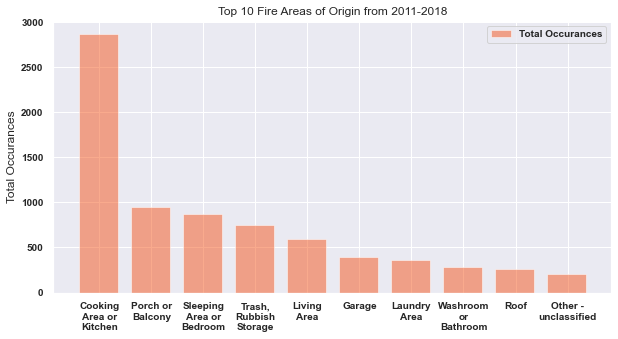

In [713]:
def wrap_labels(ax, width, break_long_words=False):
    labels = []
    for label in ax.get_xticklabels():
        text = label.get_text()
        labels.append(textwrap.fill(text, width=width,
                      break_long_words=break_long_words))
    ax.set_xticklabels(labels, rotation=0)

df_Q1 = df_topfire.head(10)
f, ax1 = plt.subplots(1, figsize=(10,5))
bar_width = 0.75
bar_l = [i+1 for i in range(len(df_Q1['Total Occurances']))] 
ax1.bar(bar_l, 
        df_Q1['Total Occurances'], 
        width=bar_width,
        label='Total Occurances', 
        alpha=0.5, 
        color='#F4561D')

tick_pos = [i+(bar_width/32) for i in bar_l]
plt.xticks(tick_pos, df_Q1['Area_of_Origin'])
ax1.set_ylabel('Total Occurances')
ax1.legend(loc='upper right', fontsize=10)
plt.title('Top 10 Fire Areas of Origin from 2011-2018')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
wrap_labels(ax1, 10)

In [714]:
#What are the top determinants (probable cause) of residential fire in Toronto over the last 9 years?

df_topfire2 = df[['Area_of_Origin','Possible_Cause']]
df_topfire2 = df_topfire2.groupby(['Area_of_Origin', 'Possible_Cause']).size().reset_index(name='Total Occurances')
df_topfidf_topfire2re = pd.DataFrame(df_topfire2)
df_topfire2 = df_topfire2.sort_values(by=['Area_of_Origin', 'Total Occurances'], ascending=[True, False])
df_topfire2 = df_topfire2.groupby('Area_of_Origin').apply(lambda x: x.sort_values(by='Total Occurances', ascending=False)).reset_index(drop=True)

df_Q2 = pd.DataFrame()
for row in area_of_origin: 
    temp = df_topfire2[df_topfire2['Area_of_Origin']==row]
    df_Q2 = pd.concat([df_Q2, temp], ignore_index=True)

#df_Q2['Area_of_Origin'] = df_Q2['Area_of_Origin'].str.split(r"\(", n=1).str[0]

fig = px.treemap(df_Q2, 
                 path=['Area_of_Origin', 'Possible_Cause'], 
                 values='Total Occurances')

fig.update_traces(textinfo='label+value')
fig.update_layout(width=1000, height=800)
fig.show()

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [715]:
#data on fire with top 15 casualties 
df['Casualties_YN'] = 'No'
df.loc[df['Civilian_Casualties'] > 0, 'Casualties_YN'] = 'Yes'
df['Displaced_YN'] = 'No'
df.loc[df['Estimated_Number_Of_Persons_Displaced'] > 0, 'Displaced_YN'] = 'Yes'
label_encoder = LabelEncoder()
df['Area_of_Origin_Endcoded'] = label_encoder.fit_transform(df['Area_of_Origin'])
df_Q4 = df.sort_values(by='Civilian_Casualties', ascending=False)
df_Q4.head(15)


,Area_of_Origin,Business_Impact,Civilian_Casualties,Count_of_Persons_Rescued,Estimated_Dollar_Loss,Estimated_Number_Of_Persons_Displaced,Ext_agent_app_or_defer_time,Extent_Of_Fire,Fire_Alarm_System_Impact_on_Evacuation,Fire_Alarm_System_Operation,Fire_Alarm_System_Presence,Fire_Under_Control_Time,Ignition_Source,Incident_Station_Area,Incident_Ward,Last_TFS_Unit_Clear_Time,Latitude,Longitude,Material_First_Ignited,Method_Of_Fire_Control,Possible_Cause,Property_Use,Smoke_Alarm_at_Fire_Origin_Alarm_Failure,Smoke_Alarm_at_Fire_Origin_Alarm_Type,Status_of_Fire_On_Arrival,TFS_Alarm_Time,TFS_Arrival_Time,Year,Casualties_YN,Displaced_YN,Area_of_Origin_Endcoded
13,"Hallway, Corridor",No business interruption,15,6,1000000,50,2016-02-05 15:30:00,"Spread beyond room of origin, same floor",All persons (at risk of injury) evacuated as a...,Fire alarm system operated,Fire alarm system present,2016-02-05 15:45:00,Undetermined,213,42.0,2016-02-06 08:58:09,43.806540,-79.218650,"Upholstered Sofa, Chair, etc.",Extinguished by fire department,Undetermined,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire with smoke showing only - including vehic...,2016-02-05 15:03:38,2016-02-05 15:08:01,2016,Yes,Yes,27
4,"Sleeping Area or Bedroom (inc. patients room, ...",Not applicable (not a business),8,11,125000,2,2018-07-08 04:35:00,"Spread beyond room of origin, same floor",Some persons (at risk) evacuated as a result o...,Fire alarm system operated,Fire alarm system present,2018-07-08 04:38:28,Matches or Lighters (unable to distinguish),442,5.0,2018-07-08 16:44:07,43.697960,-79.511539,Bedding,Extinguished by fire department,Suspected Arson,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire with no evidence from street,2018-07-08 04:08:50,2018-07-08 04:13:54,2018,Yes,Yes,62
7,Cooking Area or Kitchen,No business interruption,8,11,50000,40,2014-06-09 16:15:00,Confined to part of room/area of origin,"Not applicable: No fire alarm system, no perso...",Not applicable (no system),No Fire alarm system,2014-06-09 16:20:00,"Stove, Range-top burner",342,17.0,2014-06-09 18:12:07,43.686030,-79.443970,"Cooking Oil, Grease",Extinguished by fire department,Unattended,Multi-Unit Dwelling - Over 12 Units,Reason for inoperation undetermined,Battery operated,Fire with no evidence from street,2014-06-09 16:05:44,2014-06-09 16:09:50,2014,Yes,Yes,11
8914,"Washroom or Bathroom (toilet,restroom/locker r...",May resume operations within a week,7,0,5000,9,2015-07-17 08:15:00,Confined to part of room/area of origin,All persons (at risk of injury) evacuated as a...,Fire alarm system operated,Fire alarm system present,2015-07-17 08:13:33,Other Mechanical,111,24.0,2015-07-17 09:23:00,43.808510,-79.372510,Plastic,Extinguished by occupant,Electrical Failure,Retirement Home,Not applicable: Alarm operated OR presence/ope...,Hardwired (standalone),Fire extinguished prior to arrival,2015-07-17 08:06:31,2015-07-17 08:13:33,2015,Yes,Yes,72
11212,Porch or Balcony,Not applicable (not a business),6,0,100000,1,2018-02-24 00:44:00,Confined to part of room/area of origin,All persons (at risk of injury) evacuated as a...,Fire alarm system operated,Fire alarm system present,2018-02-24 00:48:11,"Smoker's Articles (eg. cigarettes, cigars, pip...",141,7.0,2018-02-24 04:20:37,43.763361,-79.500863,"Paper, Cardboard",Extinguished by fire department,Improperly Discarded,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Battery operated,Flames showing from small area (one storey or ...,2018-02-24 00:34:12,2018-02-24 00:38:47,2018,Yes,Yes,51
20,Cooking Area or Kitchen,Not applicable (not a business),6,5,50000,6,2015-03-28 05:57:58,"Spread to other floors, confined to building",Not applicable: Occupant(s) first alerted by o...,Fire alarm system did not operate,Fire alarm system present,2015-03-28 06:30:00,Undetermined,234,43.0,2015-03-28 14:21:04,43.762010,-79.194740,U

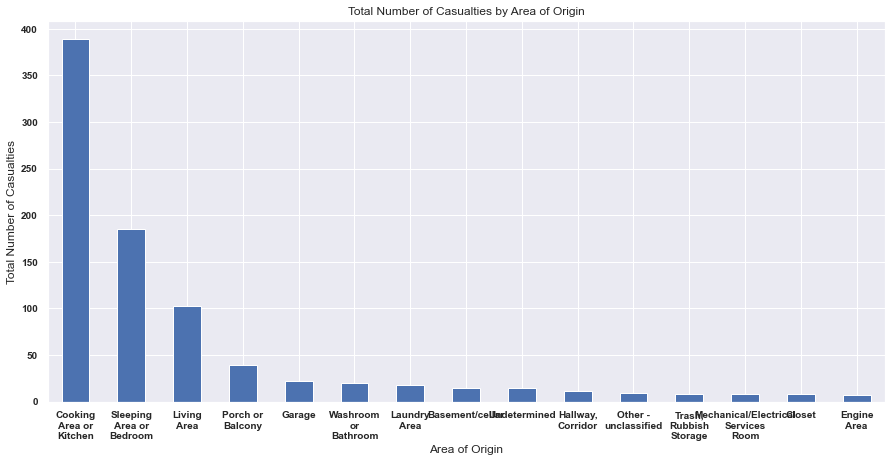

In [716]:
df_temp=df[df['Civilian_Casualties']>0].copy()
df_temp['Area_of_Origin'] =df_temp['Area_of_Origin'].str.split(r"\(", n=1).str[0]
result = df_temp.groupby('Area_of_Origin')['Civilian_Casualties'].count()
result = result.sort_values(ascending=False)
result = result.head(15)
# Create a bar plot of the result
plt.subplots(1, figsize=(15,7))
ax = result.plot(kind='bar')
# Set the title and labels for the plot
plt.title('Total Number of Casualties by Area of Origin')
plt.xlabel('Area of Origin')
plt.ylabel('Total Number of Casualties')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
wrap_labels(ax, 10)

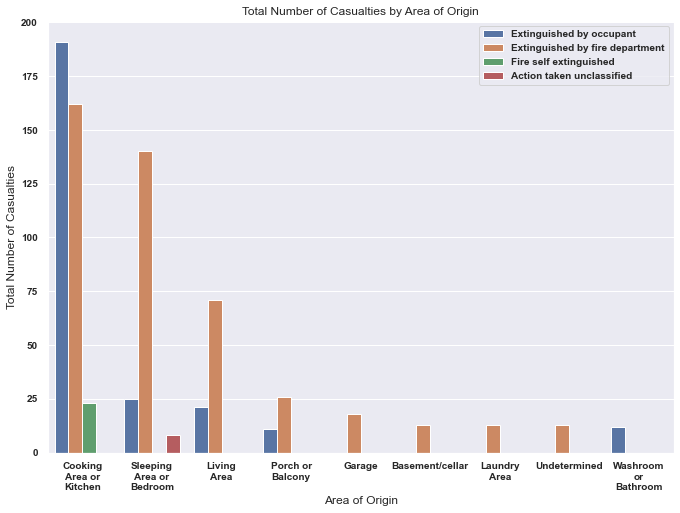

In [717]:
df_temp=df[df['Civilian_Casualties']>0].copy()
df_temp['Area_of_Origin'] =df_temp['Area_of_Origin'].str.split(r"\(", n=1).str[0]
result = df_temp.groupby(['Area_of_Origin', 'Method_Of_Fire_Control']).count()['Civilian_Casualties'].reset_index()
result = result.sort_values(by='Civilian_Casualties', ascending=False)
result = result.head(15)
# Create a bar plot of the result
plt.subplots(1, figsize=(10,7))
ax3 = sns.barplot(x='Area_of_Origin', y='Civilian_Casualties', hue='Method_Of_Fire_Control', data=result)
plt.title('Total Number of Casualties by Area of Origin')
plt.xlabel('Area of Origin')
plt.ylabel('Total Number of Casualties')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
wrap_labels(ax3, 10)
ax3.legend(loc='upper right', fontsize=10)
plt.show()

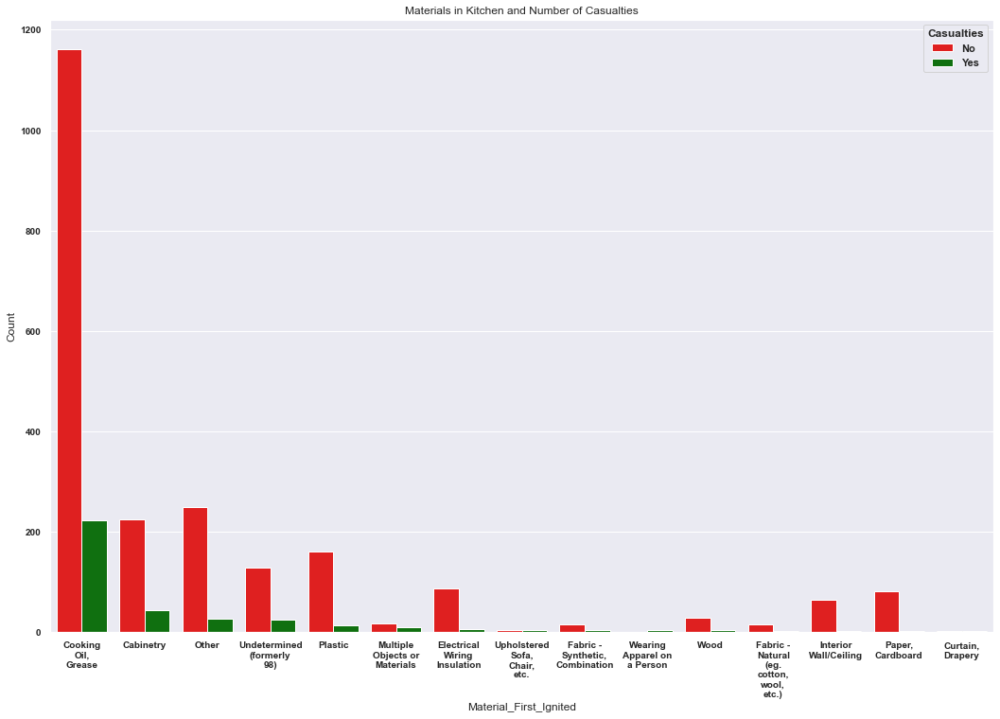

In [718]:
df_temp = df.copy()
df_temp['Area_of_Origin']=df_temp['Area_of_Origin'].str.split(r"\(", n=1).str[0]
df_temp = df_temp[df_temp['Area_of_Origin'] == 'Cooking Area or Kitchen']
result = df_temp[['Material_First_Ignited', 'Casualties_YN']].copy()
result = result.groupby(['Material_First_Ignited', 'Casualties_YN']).size().reset_index()

result.rename(columns={0: 'Count'}, inplace=True)

result2 = result.sort_values(by=['Casualties_YN', 'Count'], ascending=False).head(15)
material = result2['Material_First_Ignited']
result3 = pd.DataFrame()
for row in material: 
    temp = result[result['Material_First_Ignited']==row]
    result3 = pd.concat([result3, temp], ignore_index=True)

colors = ['red', 'green']
plt.subplots(1, figsize=(15,10))
ax4 = sns.barplot(x='Material_First_Ignited', y='Count', hue='Casualties_YN', data=result3, palette=colors)
plt.title('Materials in Kitchen and Number of Casualties')
plt.xlabel('Material_First_Ignited')
plt.ylabel('Count')
plt.legend(title='Casualties')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
wrap_labels(ax4, 10)
plt.show()

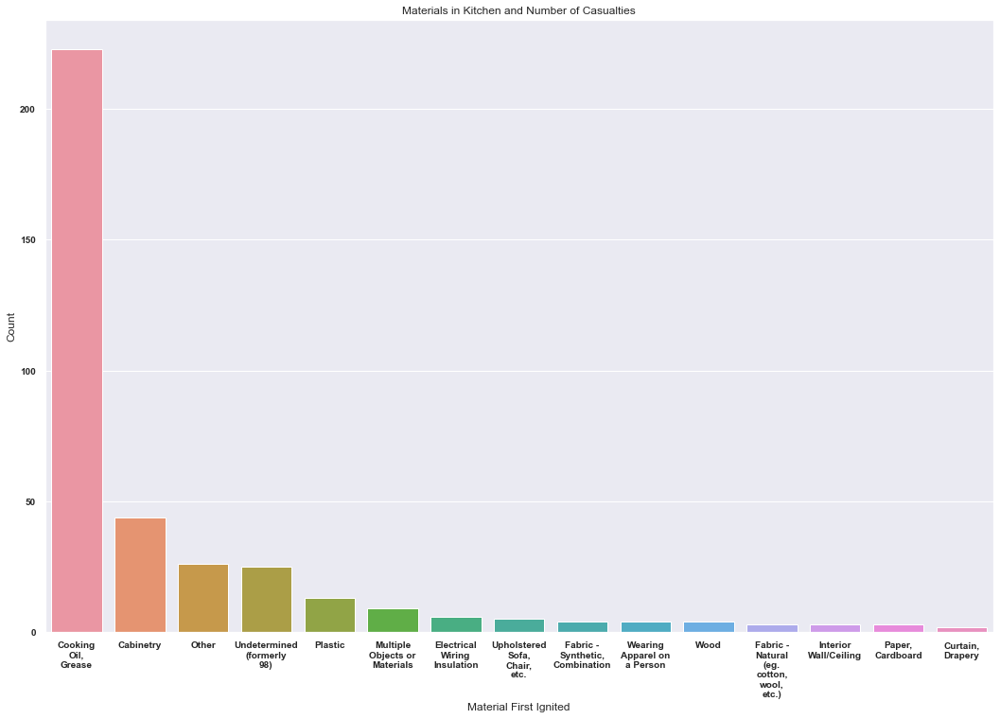

In [719]:
df_temp = df.copy()
df_temp['Area_of_Origin']=df_temp['Area_of_Origin'].str.split(r"\(", n=1).str[0]
df_temp = df_temp[df_temp['Area_of_Origin'] == 'Cooking Area or Kitchen']
result = df_temp[['Material_First_Ignited', 'Casualties_YN']].copy()
result = result.groupby(['Material_First_Ignited', 'Casualties_YN']).size().reset_index()

result.rename(columns={0: 'Count'}, inplace=True)

result2 = result.sort_values(by=['Casualties_YN', 'Count'], ascending=False).head(15)
material = result2['Material_First_Ignited']
result3 = pd.DataFrame()
for row in material: 
    temp = result[result['Material_First_Ignited']==row]
    result3 = pd.concat([result3, temp], ignore_index=True)

result3 = result3[result3['Casualties_YN'] == "Yes"]
plt.subplots(1, figsize=(15,10))
ax4 = sns.barplot(x='Material_First_Ignited', y='Count', data=result3)
plt.title('Materials in Kitchen and Number of Casualties')
plt.xlabel('Material First Ignited')
plt.ylabel('Count')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
wrap_labels(ax4, 10)
plt.show()

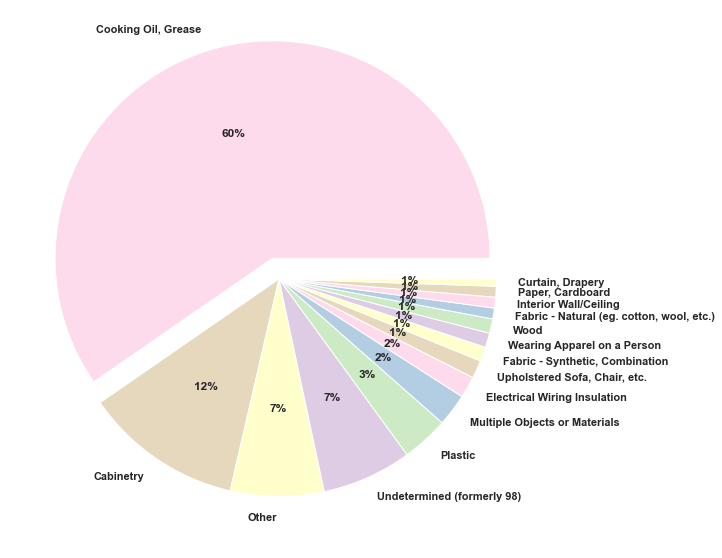

In [720]:
# importing libraries
import matplotlib.pyplot as plt
import seaborn
  
sns.set(font_scale = 1)
plt.figure(figsize=(10,10))

# declaring exploding pie
explode = [0.1, 0, 0, 0, 0, 0, 0, 0, 0,0,0,0,0,0,0]
# define Seaborn color palette to use
palette_color = seaborn.color_palette('Pastel1_r')
  
# plotting data on chart
plt.pie(result3['Count'], labels=result3['Material_First_Ignited'], colors=palette_color,
        explode=explode, autopct='%.0f%%')
  
# displaying chart
plt.show()

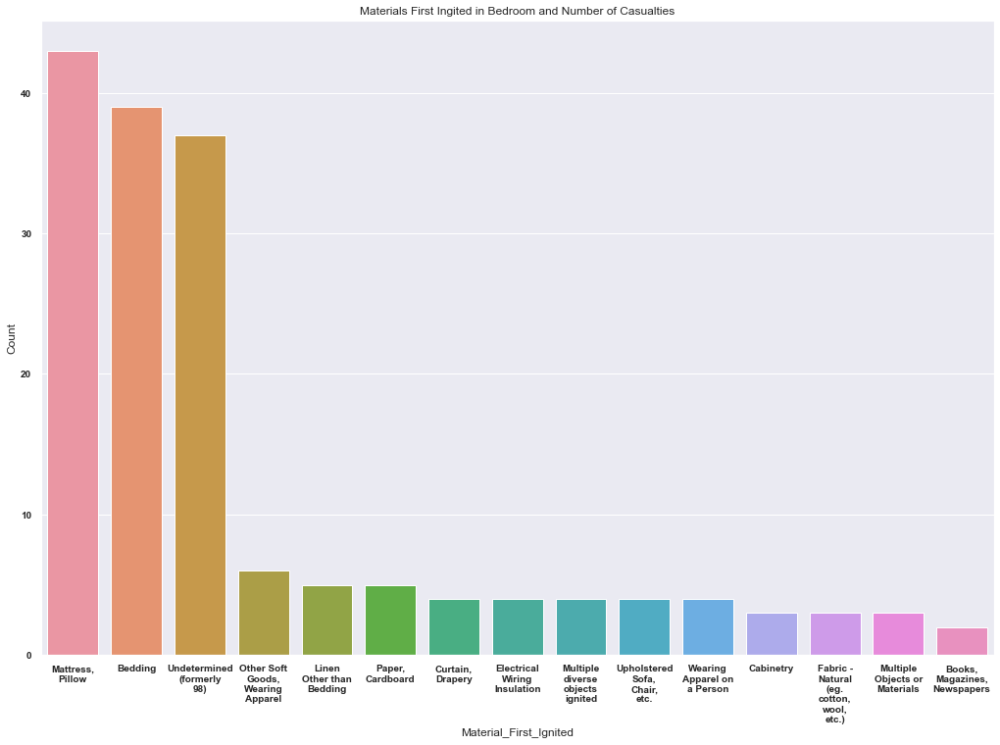

In [721]:
df_temp = df.copy()
df_temp = df_temp[df['Area_of_Origin_Endcoded'] == 62]
result = df_temp[['Material_First_Ignited', 'Casualties_YN']].copy()
result = result.groupby(['Material_First_Ignited', 'Casualties_YN']).size().reset_index()

result.rename(columns={0: 'Count'}, inplace=True)

result2 = result.sort_values(by=['Casualties_YN', 'Count'], ascending=False).head(15)
material = result2['Material_First_Ignited']
result3 = pd.DataFrame()
for row in material: 
    temp = result[result['Material_First_Ignited']==row]
    result3 = pd.concat([result3, temp], ignore_index=True)
result3 = result3[result3['Casualties_YN'] == "Yes"]

plt.subplots(1, figsize=(15,10))
ax4 = sns.barplot(x='Material_First_Ignited', y='Count', data=result3)
plt.title('Materials First Ingited in Bedroom and Number of Casualties')
plt.xlabel('Material_First_Ignited')
plt.ylabel('Count')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
wrap_labels(ax4, 10)
plt.show()

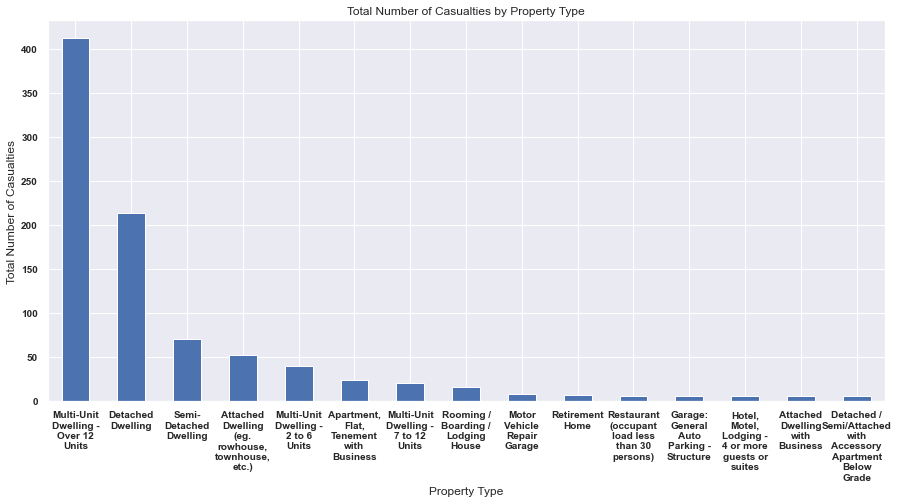

In [722]:
#most dangerous types of buildings
df_temp=df[df['Civilian_Casualties']>0].copy()
result = df_temp.groupby('Property_Use')['Civilian_Casualties'].count()
result = result.sort_values(ascending=False)
result = result.head(15)
result.rename(index={'Rooming/Boarding/Lodging House':'Rooming / Boarding / Lodging House'},inplace=True)
result.rename(index={'Detached/Semi/Attached with Accessory Apartment Below Grade':'Detached / Semi/Attached with Accessory Apartment Below Grade'},inplace=True)

# Create a bar plot of the result
plt.subplots(1, figsize=(15,7))
ax = result.plot(kind='bar')
# Set the title and labels for the plot
plt.title('Total Number of Casualties by Property Type')
plt.xlabel('Property Type')
plt.ylabel('Total Number of Casualties')
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
wrap_labels(ax, 10)

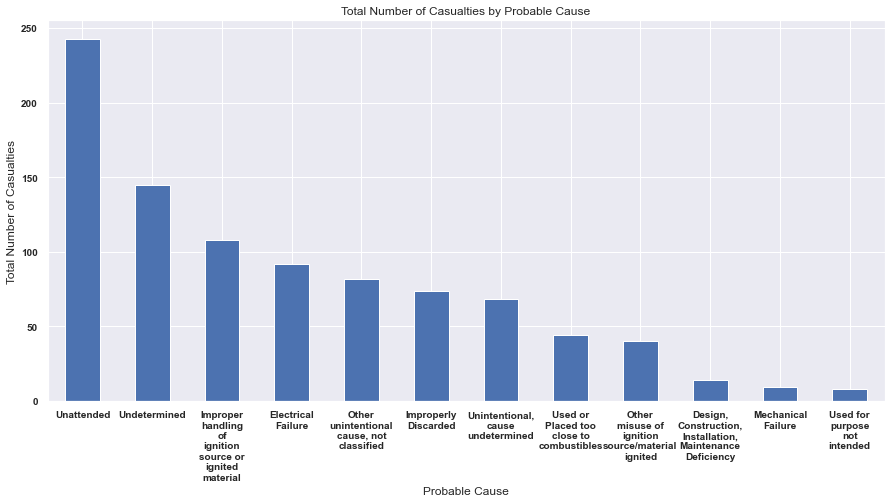

In [723]:
#probably cause that result in casualties 
df_temp=df[df['Civilian_Casualties']>0].copy()
result = df_temp.groupby('Possible_Cause')['Civilian_Casualties'].count()
result = result.sort_values(ascending=False)
result = result.head(12)
result.rename(index={'Design/Construction/Installation/Maintenance Deficiency':'Design, Construction, Installation, Maintenance Deficiency'},inplace=True)

# Create a bar plot of the result
plt.subplots(1, figsize=(15,7))
ax = result.plot(kind='bar')
# Set the title and labels for the plot
plt.title('Total Number of Casualties by Probable Cause')
plt.xlabel('Probable Cause')
plt.ylabel('Total Number of Casualties')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
wrap_labels(ax, 10)

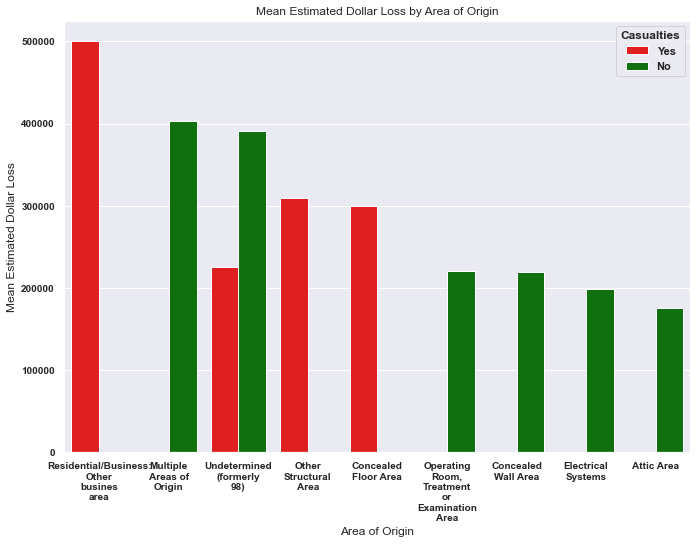

In [724]:
df_mean = df.groupby(['Area_of_Origin', 'Casualties_YN'])['Estimated_Dollar_Loss'].mean().reset_index()
df_avg_money_loss = df_mean.sort_values(by='Estimated_Dollar_Loss', ascending=False)
df_avg_money_loss = df_avg_money_loss[df_avg_money_loss['Area_of_Origin']!="Under Investigation"].head(10)
colors = ['red', 'green']
plt.subplots(1, figsize=(10,7))
ax3 = sns.barplot(x='Area_of_Origin', y='Estimated_Dollar_Loss', hue='Casualties_YN', data=df_avg_money_loss, palette=colors)
plt.title('Mean Estimated Dollar Loss by Area of Origin')
plt.xlabel('Area of Origin')
plt.ylabel('Mean Estimated Dollar Loss')
plt.legend(title='Casualties')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
wrap_labels(ax3, 10)
plt.show()

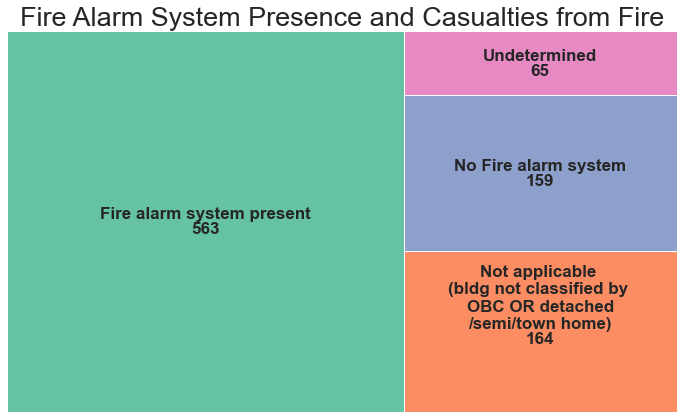

In [725]:
#cat plot yes/no casualties and smoke alarm 
#Fire_Alarm_System_Impact_on_Evacuation	Fire_Alarm_System_Operation	Fire_Alarm_System_Presence
import squarify
import matplotlib

df_temp=df[df['Civilian_Casualties']>0].copy()
result = df_temp.groupby('Fire_Alarm_System_Presence')['Civilian_Casualties'].count()
result = result.sort_values(ascending=False)
result = result.head(12)
result.rename(index={'Not applicable (bldg not classified by OBC OR detached/semi/town home)':'Not applicable \n(bldg not classified by \nOBC OR detached\n/semi/town home)'},inplace=True)

result = pd.DataFrame(result).reset_index()
result.columns =['Fire_Alarm_System_Presence', 'Civilian_Casualties']
plt.figure(figsize=(12,7))
squarify.plot(sizes=result['Civilian_Casualties'], label=result['Fire_Alarm_System_Presence'], value=result['Civilian_Casualties'],
              color=[matplotlib.cm.Set2(i) for i in range(7)],
              text_kwargs={'fontsize': 17})
plt.title('Fire Alarm System Presence and Casualties from Fire', fontsize=27)
plt.axis('off')
plt.show()

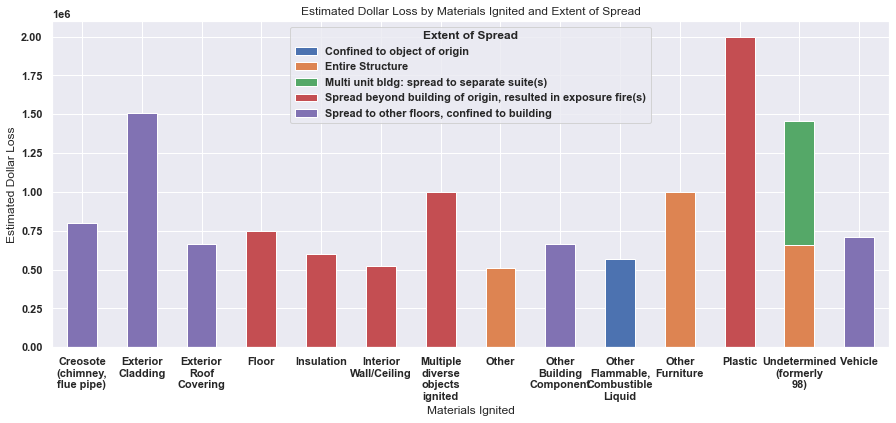

In [726]:
df_sum = df.groupby(['Material_First_Ignited', 'Extent_Of_Fire'])['Estimated_Dollar_Loss'].mean().reset_index()
df_sum = df_sum.sort_values(by='Estimated_Dollar_Loss', ascending=False)
df_sum = df_sum[df_sum['Material_First_Ignited']!="Under Investigation"]
df_sum_top15 = df_sum.head(15)
df_pivot = df_sum_top15.pivot(index='Material_First_Ignited', columns='Extent_Of_Fire', values='Estimated_Dollar_Loss')
ax = df_pivot.plot(kind='bar', stacked=True, figsize=(15, 6))
ax.set_xlabel('Materials Ignited')
ax.set_ylabel('Estimated Dollar Loss')
ax.set_title('Estimated Dollar Loss by Materials Ignited and Extent of Spread')
plt.legend(title='Extent of Spread')
wrap_labels(ax, 10)
plt.show()

In [727]:
df_count = df_filtered.groupby(['Extent_Of_Fire', 'Material_First_Ignited']).size()
df_count = pd.DataFrame(df_count).reset_index()
df_count = df_count[df_count['Material_First_Ignited'] != 'Undetermined (formerly 98)']
df_count.rename(columns={0: 'Count'}, inplace=True)

#parent
extent_of_fire = df_count.groupby('Extent_Of_Fire')['Count'].sum().reset_index()
extent_of_fire = extent_of_fire.sort_values(by=['Count'], ascending=False).reset_index()
extent_of_fire = extent_of_fire[['Extent_Of_Fire', 'Count']]
extent_of_fire

sorted_df = pd.DataFrame()
for ind in extent_of_fire.index:
    
    extent_type = extent_of_fire['Extent_Of_Fire'][ind]
    fire_df = df_count[df_count['Extent_Of_Fire']==extent_type]
    
    material_first_ignited = fire_df.groupby('Material_First_Ignited')['Count'].sum().reset_index()
    material_first_ignited = material_first_ignited.sort_values(by=['Count'], ascending=False)
    
    for ind in material_first_ignited.index:
        temp = material_first_ignited['Material_First_Ignited'][ind]
        mat_df = df_count[df_count['Material_First_Ignited']==temp].sort_values(by=['Count'], ascending=False)
        sorted_df = pd.concat([sorted_df, mat_df], ignore_index=True)

sorted_df = sorted_df[sorted_df['Count']>15]

colors = ['rgb(254,235,226)', 'rgb(252,197,192)', 'rgb(250,159,181)', 'rgb(247,104,161)', 'rgb(197,27,138)']

fig = px.treemap(sorted_df, 
                 path=['Extent_Of_Fire', 'Material_First_Ignited'], 
                 values='Count', color_continuous_scale=colors)


fig.update_traces(textinfo='label+value')
fig.update_layout(width=1000, height=800)

fig.show()

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [728]:
df_count = df_filtered.groupby(['Extent_Of_Fire', 'Material_First_Ignited']).size()
df_count = pd.DataFrame(df_count).reset_index()
df_count = df_count[df_count['Material_First_Ignited'] != 'Undetermined (formerly 98)']
df_count = df_count[df_count['Material_First_Ignited'] != 'Undetermined']
df_count = df_count[df_count['Extent_Of_Fire'] != 'Confined to object of origin']
df_count = df_count[df_count['Extent_Of_Fire'] != 'Confined to part of room/area of origin']
df_count = df_count[df_count['Extent_Of_Fire'] != 'Confined to roof/exterior structure']
df_count.rename(columns={0: 'Count'}, inplace=True)

#parent
extent_of_fire = df_count.groupby('Extent_Of_Fire')['Count'].sum().reset_index()
extent_of_fire = extent_of_fire.sort_values(by=['Count'], ascending=False).reset_index()
extent_of_fire = extent_of_fire[['Extent_Of_Fire', 'Count']]
extent_of_fire

sorted_df = pd.DataFrame()
for ind in extent_of_fire.index:
    
    extent_type = extent_of_fire['Extent_Of_Fire'][ind]
    fire_df = df_count[df_count['Extent_Of_Fire']==extent_type]
    
    material_first_ignited = fire_df.groupby('Material_First_Ignited')['Count'].sum().reset_index()
    material_first_ignited = material_first_ignited.sort_values(by=['Count'], ascending=False)
    
    for ind in material_first_ignited.index:
        temp = material_first_ignited['Material_First_Ignited'][ind]
        mat_df = df_count[df_count['Material_First_Ignited']==temp].sort_values(by=['Count'], ascending=False)
        sorted_df = pd.concat([sorted_df, mat_df], ignore_index=True)

sorted_df = sorted_df[sorted_df['Count']>5]

colors = ['rgb(254,235,226)', 'rgb(252,197,192)', 'rgb(250,159,181)', 'rgb(247,104,161)', 'rgb(197,27,138)']

fig = px.treemap(sorted_df, 
                 path=['Extent_Of_Fire', 'Material_First_Ignited'], 
                 values='Count', color_continuous_scale=colors)


fig.update_traces(textinfo='label+value')
fig.update_layout(width=1000, height=800)

fig.show()

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/user/opt/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [729]:
#which areas receive the most fire emergency calls 
!pip install geopandas
!pip install matplotlib
!pip install contextily


In [730]:
!pip install folium

/Users/user/opt/anaconda3/lib/python3.9/site-packages/contextily/tile.py:581: UserWarning:

The inferred zoom level of 29 is not valid for the current tile provider (valid zooms: 0 - 20).



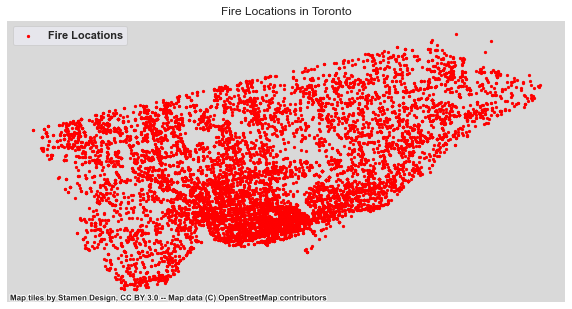

In [731]:
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import matplotlib.pyplot as plt
import plotly.graph_objects as go


gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['Longitude'], df['Latitude']))
toronto_map = ctx.providers.Stamen.TonerLite
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(ax=ax, markersize=5, color='red', label='Fire Locations')
ax.set_title('Fire Locations in Toronto')
ax.set_axis_off()
ctx.add_basemap(ax, crs=gdf.crs, source=toronto_map)
plt.legend()
plt.show()

In [757]:
def get_borough(lat, lon):
    # Define the coordinates for each borough
    etobicoke = {'nw_lat': 43.7236, 'nw_lon': -79.6056, 'ne_lat': 43.7236, 'ne_lon': -79.4949, 'se_lat': 43.5903, 'se_lon': -79.4949, 'sw_lat': 43.5903, 'sw_lon': -79.6056}
    north_york = {'nw_lat': 43.8258, 'nw_lon': -79.5541, 'ne_lat': 43.8258, 'ne_lon': -79.3330, 'se_lat': 43.6684, 'se_lon': -79.3330, 'sw_lat': 43.6684, 'sw_lon': -79.5541}
    scarborough = {'nw_lat': 43.9393, 'nw_lon': -79.3396, 'ne_lat': 43.9393, 'ne_lon': -79.1120, 'se_lat': 43.6714, 'se_lon': -79.1120, 'sw_lat': 43.6714, 'sw_lon': -79.3396}
    york = {'nw_lat': 43.7616, 'nw_lon': -79.5219, 'ne_lat': 43.7616, 'ne_lon': -79.4303, 'se_lat': 43.6833, 'se_lon': -79.4303, 'sw_lat': 43.6833, 'sw_lon': -79.5219}
    east_york = {'nw_lat': 43.7218, 'nw_lon': -79.3570, 'ne_lat': 43.7218, 'ne_lon': -79.3018, 'se_lat': 43.6903, 'se_lon': -79.3018, 'sw_lat': 43.6903, 'sw_lon': -79.3570}
    old_toronto = {'nw_lat': 43.7296, 'nw_lon': -79.4312, 'ne_lat': 43.7296, 'ne_lon': -79.3639, 'se_lat': 43.6413, 'se_lon': -79.3639, 'sw_lat': 43.6413, 'sw_lon': -79.4312}
    
    # Check if the coordinates fall within each borough
    if (etobicoke['nw_lat'] >= lat >= etobicoke['sw_lat']) and (etobicoke['nw_lon'] <= lon <= etobicoke['ne_lon']):
        return 'Etobicoke'
    elif (north_york['nw_lat'] >= lat >= north_york['sw_lat']) and (north_york['nw_lon'] <= lon <= north_york['ne_lon']):
        return 'North York'
    elif (scarborough['nw_lat'] >= lat >= scarborough['sw_lat']) and (scarborough['nw_lon'] <= lon <= scarborough['ne_lon']):
        return 'Scarborough'
    elif (york['nw_lat'] >= lat >= york['sw_lat']) and (york['nw_lon'] <= lon <= york['ne_lon']):
        return 'York'
    elif (old_toronto['nw_lat'] >= lat >= old_toronto['sw_lat']) and (old_toronto['nw_lon'] <= lon <= old_toronto['ne_lon']):
        return 'Old Toronto'
    else: 
        return "East York"
    
df["Borough"] = "Unknown"

for i, row in df.iterrows(): 
    
    long = row["Longitude"]
    lat = row["Latitude"]
    b = get_borough(lat, long)
    df.at[i,'Borough'] = b

df.head()
    

,Area_of_Origin,Business_Impact,Civilian_Casualties,Count_of_Persons_Rescued,Estimated_Dollar_Loss,Estimated_Number_Of_Persons_Displaced,Ext_agent_app_or_defer_time,Extent_Of_Fire,Fire_Alarm_System_Impact_on_Evacuation,Fire_Alarm_System_Operation,Fire_Alarm_System_Presence,Fire_Under_Control_Time,Ignition_Source,Incident_Station_Area,Incident_Ward,Last_TFS_Unit_Clear_Time,Latitude,Longitude,Material_First_Ignited,Method_Of_Fire_Control,Possible_Cause,Property_Use,Smoke_Alarm_at_Fire_Origin_Alarm_Failure,Smoke_Alarm_at_Fire_Origin_Alarm_Type,Status_of_Fire_On_Arrival,TFS_Alarm_Time,TFS_Arrival_Time,Year,Casualties_YN,Displaced_YN,Area_of_Origin_Endcoded,geometry,Borough
0,Porch or Balcony,No business interruption,0,86,3000,0,2018-08-24 17:06:26,Confined to object of origin,Not applicable: Occupant(s) first alerted by o...,Fire alarm system did not operate,Fire alarm system present,2018-08-24 17:06:28,Undetermined,114,18.0,2018-08-24 17:42:43,43.760357,-79.412479,Undetermined (formerly 98),Extinguished by fire department,Undetermined,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Hardwired (standalone),Fire with smoke showing only - including vehic...,2018-08-24 16:49:36,2018-08-24 16:54:09,2018,No,No,51,POINT (-79.41248 43.76036),North York
1,Cooking Area or Kitchen,Undetermined,0,28,50000,28,2018-11-24 07:19:00,Confined to part of room/area of origin,Not applicable: Occupant(s) first alerted by o...,Fire alarm system operated,Fire alarm system present,2018-11-24 07:19:00,"Other Cooking Items (eg Toaster, Kettle, elec ...",142,7.0,2018-11-24 12:45:21,43.754542,-79.530419,Plastic,Extinguished by occupant,Under Investigation,Infirmary,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire extinguished prior to arrival,2018-11-24 07:09:12,2018-11-24 07:14:23,2018,No,Yes,11,POINT (-79.53042 43.75454),North York
2,"Living Area (e.g. living, TV, recreation, etc)",Not applicable (not a business),1,16,1000000,130,2017-02-09 18:02:13,"Spread beyond room of origin, same floor",Some persons (at risk) evacuated as a result o...,Fire alarm system operated,Fire alarm system present,2017-02-09 18:36:21,Undetermined,325,27.0,2017-02-09 23:36:33,43.657300,-79.373460,Undetermined (formerly 98),Extinguished by fire department,Undetermined,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Hardwired (standalone),Flames showing from small area (one storey or ...,2017-02-09 17:45:07,2017-02-09 17:48:49,2017,Yes,Yes,31,POINT (-79.37346 43.65730),Old Toronto
3,Undetermined (formerly 98),May not resume operations,0,12,1000000,14,2012-10-30 00:52:04,Entire Structure,Undetermined,Fire alarm system operation undetermined,Undetermined,2012-10-30 01:28:48,Undetermined,332,20.0,2012-11-01 16:30:31,43.649350,-79.393700,Undetermined (formerly 98),Extinguished by fire department,Undetermined,"Clothing Store, Accessories, fur",Not applicable: Alarm operated OR presence/ope...,Type undetermined,Flames showing from large area (more than one ...,2012-10-30 00:42:01,2012-10-30 00:44:58,2012,No,Yes,70,POINT (-79.39370 43.64935),Old Toronto
4,"Sleeping Area or Bedroom (inc. patients room, ...",Not applicable (not a business),8,11,125000,2,2018-07-08 04:35:00,"Spread beyond room of origin, same floor",Some persons (at risk) evacuated as a result o...,Fire alarm system operated,Fire alarm system present,2018-07-08 04:38:28,Matches or Lighters (unable to distinguish),442,5.0,2018-07-08 16:44:07,43.697960,-79.511539,Bedding,Extinguished by fire department,Suspected Arson,Multi-Unit Dwelling - Over 12 Units,Not applicable: Alarm operated OR presence/ope...,Interconnected,Fire with no evidence from street,2018-07-08 04:08:50,2018-07-08 04:13:54,2018,Yes,Yes,62,POINT (-79.51154 43.69796),Etobicoke


In [758]:
df['Year'] = df['TFS_Alarm_Time'].dt.year
df_2012 = df[df['Year'] == 2012].copy()

In [759]:
df_2012 = df[df['Year'] == 2012].copy()
df_borough = df_2012.groupby('Borough').size().reset_index(name='FireCount')
print(df_borough)
coordinates = {'Etobicoke': {'Latitude': 43.6205, 'Longitude': -79.5132},
               'North York': {'Latitude': 43.7615, 'Longitude': -79.4111},
               'Scarborough': {'Latitude': 43.7731, 'Longitude': -79.2578},
               'York': {'Latitude': 43.6895, 'Longitude': -79.4700},
               'East York': {'Latitude': 43.6912, 'Longitude': -79.3417},
               'Old Toronto': {'Latitude': 43.6519, 'Longitude': -79.3817}}

#df_borough['Latitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Latitude'])
#df_borough['Longitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Longitude'])
Latitude = [43.6912, 43.6205, 43.7615, 43.6519, 43.7731 ]
Longitude = [-79.3417, -79.5132, -79.4111, -79.3817, -79.2578]
df_borough['Latitude'] = Latitude
df_borough['Longitude'] = Longitude

print(df_borough)

# Create a folium map centered at Toronto
toronto_map = folium.Map(location=[43.70, -79.42], zoom_start=11)

# Iterate through the dataframe rows
for index, row in df_borough.iterrows():
    # Create a circle marker for each row with size based on FireCount
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=row['FireCount'] / 6,  # proportionate size based on FireCount
        popup=f"Borough: {row['Borough']}<br>FireCount: {row['FireCount']}",
        fill=True,
        fill_opacity=0.7,
        color='red',
        fill_color='red',
    ).add_to(toronto_map)

# Display the map
toronto_map


       Borough  FireCount
0    East York        222
1    Etobicoke        142
2   North York        472
3  Old Toronto        188
4  Scarborough        330
       Borough  FireCount  Latitude  Longitude
0    East York        222   43.6912   -79.3417
1    Etobicoke        142   43.6205   -79.5132
2   North York        472   43.7615   -79.4111
3  Old Toronto        188   43.6519   -79.3817
4  Scarborough        330   43.7731   -79.2578


In [735]:
df_2012 = df[df['Year'] == 2011].copy()
df_borough = df_2012.groupby('Borough').size().reset_index(name='FireCount')

coordinates = {'Etobicoke': {'Latitude': 43.6205, 'Longitude': -79.5132},
               'North York': {'Latitude': 43.7615, 'Longitude': -79.4111},
               'Scarborough': {'Latitude': 43.7731, 'Longitude': -79.2578},
               'York': {'Latitude': 43.6895, 'Longitude': -79.4700},
               'East York': {'Latitude': 43.6912, 'Longitude': -79.3417},
               'Old Toronto': {'Latitude': 43.6519, 'Longitude': -79.3817}}

#df_borough['Latitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Latitude'])
#df_borough['Longitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Longitude'])
Latitude = [43.6912, 43.6205, 43.7615, 43.6519, 43.7731 ]
Longitude = [-79.3417, -79.5132, -79.4111, -79.3817, -79.2578]
df_borough['Latitude'] = Latitude
df_borough['Longitude'] = Longitude

print(df_borough)

# Create a folium map centered at Toronto
toronto_map = folium.Map(location=[43.70, -79.42], zoom_start=11)

# Iterate through the dataframe rows
for index, row in df_borough.iterrows():
    # Create a circle marker for each row with size based on FireCount
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=row['FireCount'] / 6,  # proportionate size based on FireCount
        popup=f"Borough: {row['Borough']}<br>FireCount: {row['FireCount']}",
        fill=True,
        fill_opacity=0.7,
        color='red',
        fill_color='red',
    ).add_to(toronto_map)

# Display the map
toronto_map



       Borough  FireCount  Latitude  Longitude
0    East York        183   43.6912   -79.3417
1    Etobicoke        179   43.6205   -79.5132
2   North York        473   43.7615   -79.4111
3  Old Toronto        182   43.6519   -79.3817
4  Scarborough        300   43.7731   -79.2578


In [736]:

df_borough = df.groupby('Borough').size().reset_index(name='FireCount')

coordinates = {'Etobicoke': {'Latitude': 43.6205, 'Longitude': -79.5132},
               'North York': {'Latitude': 43.7615, 'Longitude': -79.4111},
               'Scarborough': {'Latitude': 43.7731, 'Longitude': -79.2578},
               'York': {'Latitude': 43.6895, 'Longitude': -79.4700},
               'East York': {'Latitude': 43.6912, 'Longitude': -79.3417},
               'Old Toronto': {'Latitude': 43.6519, 'Longitude': -79.3817}}

#df_borough['Latitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Latitude'])
#df_borough['Longitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Longitude'])
Latitude = [43.6912, 43.6205, 43.7615, 43.6519, 43.7731 ]
Longitude = [-79.3417, -79.5132, -79.4111, -79.3817, -79.2578]
df_borough['Latitude'] = Latitude
df_borough['Longitude'] = Longitude

print(df_borough)

# Create a folium map centered at Toronto
toronto_map = folium.Map(location=[43.70, -79.42], zoom_start=11)

# Iterate through the dataframe rows
for index, row in df_borough.iterrows():
    # Create a circle marker for each row with size based on FireCount
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=row['FireCount'] / 50,  # proportionate size based on FireCount
        popup=f"Borough: {row['Borough']}<br>FireCount: {row['FireCount']}",
        fill=True,
        fill_opacity=0.7,
        color='red',
        fill_color='red',
    ).add_to(toronto_map)

# Display the map
toronto_map

       Borough  FireCount  Latitude  Longitude
0    East York       1759   43.6912   -79.3417
1    Etobicoke       1356   43.6205   -79.5132
2   North York       3892   43.7615   -79.4111
3  Old Toronto       1584   43.6519   -79.3817
4  Scarborough       2623   43.7731   -79.2578


In [737]:

df_borough = df_2012.groupby('Borough').size().reset_index(name='FireCount')

coordinates = {'Etobicoke': {'Latitude': 43.6205, 'Longitude': -79.5132},
               'North York': {'Latitude': 43.7615, 'Longitude': -79.4111},
               'Scarborough': {'Latitude': 43.7731, 'Longitude': -79.2578},
               'York': {'Latitude': 43.6895, 'Longitude': -79.4700},
               'East York': {'Latitude': 43.6912, 'Longitude': -79.3417},
               'Old Toronto': {'Latitude': 43.6519, 'Longitude': -79.3817}}

#df_borough['Latitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Latitude'])
#df_borough['Longitude'] = df_borough['Borough'].map(lambda x: coordinates[x]['Longitude'])
Latitude = [43.6912, 43.6205, 43.7615, 43.6519, 43.7731 ]
Longitude = [-79.3417, -79.5132, -79.4111, -79.3817, -79.2578]
df_borough['Latitude'] = Latitude
df_borough['Longitude'] = Longitude

In [738]:
coordinates = {'Etobicoke': {'Latitude': 43.6205, 'Longitude': -79.5132},
               'North York': {'Latitude': 43.7615, 'Longitude': -79.4111},
               'Scarborough': {'Latitude': 43.7731, 'Longitude': -79.2578},
               'York': {'Latitude': 43.6895, 'Longitude': -79.4700},
               'East York': {'Latitude': 43.6912, 'Longitude': -79.3417},
               'Old Toronto': {'Latitude': 43.6519, 'Longitude': -79.3817}}
Latitude = [43.6912, 43.6205, 43.7615, 43.6519, 43.7731 ]
Longitude = [-79.3417, -79.5132, -79.4111, -79.3817, -79.2578]

df_2011 = df[df['Year'] == 2011].copy()
df_2012 = df[df['Year'] == 2012].copy()
df_2013 = df[df['Year'] == 2013].copy()
df_2014 = df[df['Year'] == 2014].copy()
df_2015 = df[df['Year'] == 2015].copy()
df_2016 = df[df['Year'] == 2016].copy()
df_2017 = df[df['Year'] == 2017].copy()
df_2018 = df[df['Year'] == 2018].copy()

df_borough11 = df_2011.groupby('Borough').size().reset_index(name='FireCount')

df_borough11['Latitude'] = Latitude
df_borough11['Longitude'] = Longitude
df_borough11["Year"] = 2011

df_borough12 = df_2012.groupby('Borough').size().reset_index(name='FireCount')

df_borough12['Latitude'] = Latitude
df_borough12['Longitude'] = Longitude
df_borough12["Year"] = 2012

df_borough13 = df_2013.groupby('Borough').size().reset_index(name='FireCount')

df_borough13['Latitude'] = Latitude
df_borough13['Longitude'] = Longitude
df_borough13["Year"] = 2013

df_borough14 = df_2014.groupby('Borough').size().reset_index(name='FireCount')

df_borough14['Latitude'] = Latitude
df_borough14['Longitude'] = Longitude
df_borough14["Year"] = 2014

df_borough15 = df_2015.groupby('Borough').size().reset_index(name='FireCount')

df_borough15['Latitude'] = Latitude
df_borough15['Longitude'] = Longitude
df_borough15["Year"] = 2015

df_borough16 = df_2016.groupby('Borough').size().reset_index(name='FireCount')

df_borough16['Latitude'] = Latitude
df_borough16['Longitude'] = Longitude
df_borough16["Year"] = 2016

df_borough17 = df_2017.groupby('Borough').size().reset_index(name='FireCount')

df_borough17['Latitude'] = Latitude
df_borough17['Longitude'] = Longitude
df_borough17["Year"] = 2017

df_borough18 = df_2018.groupby('Borough').size().reset_index(name='FireCount')

df_borough18['Latitude'] = Latitude
df_borough18['Longitude'] = Longitude
df_borough18["Year"] = 2018

merged_df = pd.concat([df_borough11, df_borough12, df_borough13, df_borough14, df_borough15, df_borough16, df_borough17, df_borough18], axis=0)

merged_df



,Borough,FireCount,Latitude,Longitude,Year
0,East York,183,43.6912,-79.3417,2011
1,Etobicoke,179,43.6205,-79.5132,2011
2,North York,473,43.7615,-79.4111,2011
3,Old Toronto,182,43.6519,-79.3817,2011
4,Scarborough,300,43.7731,-79.2578,2011
0,East York,222,43.6912,-79.3417,2012
1,Etobicoke,142,43.6205,-79.5132,2012
2,North York,472,43.7615,-79.4111,2012
3,Old Toronto,188,43.6519,-79.3817,2012
4,Scarborough,330,43.7731,-79.2578,2012


In [739]:
import folium

# Create a folium map centered at Toronto
toronto_map = folium.Map(location=[43.70, -79.42], zoom_start=11)
years_list = [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]
colors = ["red", "green", "blue", "yellow", "orange", "purple", "pink", "brown"]
offset = 0.005  # adjust this value to set the desired offset

# Sort the years_list in ascending order
years_list = sorted(years_list)

# Iterate through the years_list
for i, year in enumerate(years_list):
    year_df = merged_df[merged_df['Year'] == year]
    
    # Calculate offset based on index of year in years_list
    offset_lat = offset * (i+1)
    offset_lon = offset * (i+1)
    
    # Create a circle marker for each row with size based on FireCount
    for index, row in year_df.iterrows():
        # Add offset to latitude and longitude
        lat = row['Latitude'] + offset_lat
        lon = row['Longitude'] + offset_lon
        
        folium.CircleMarker(
            location=[lat, lon],  # use offset latitude and longitude
            radius=row['FireCount'] / 10,
            popup=f"Borough: {row['Borough']}<br>FireCount: {row['FireCount']}<br>Year: {year}",
            fill=True,
            fill_opacity=0.7,
            color=colors[i],  # use color based on year
            fill_color=colors[i],
        ).add_to(toronto_map)

# Display the map
toronto_map



In [740]:
import folium

# Create a folium map centered at Toronto
toronto_map = folium.Map(location=[43.70, -79.42], zoom_start=11)
years_list = [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]
colors = ["red", "green", "blue", "yellow", "orange", "purple", "pink", "brown"]
offset = 0.005  # adjust this value to set the desired offset

# Sort the years_list in ascending order
years_list = sorted(years_list)

# Create a dictionary to store FireCount values for each year
firecount_dict = {}

# Iterate through the years_list
for i, year in enumerate(years_list):
    year_df = merged_df[merged_df['Year'] == year]
    
    # Calculate offset based on index of year in years_list
    offset_lat = offset * (i+1)
    offset_lon = offset * (i+1)
    
    # Store FireCount values in the dictionary
    firecount_dict[year] = year_df['FireCount'].tolist()
    
    # Create a circle marker for each row with size based on FireCount
    for index, row in year_df.iterrows():
        # Add offset to latitude and longitude
        lat = row['Latitude'] + offset_lat
        lon = row['Longitude'] + offset_lon
        
        # Retrieve FireCount value from the dictionary using the index
        firecount = firecount_dict[year][index]
        
        folium.CircleMarker(
            location=[lat, lon],  # use offset latitude and longitude
            radius=firecount / 7,  # use retrieved FireCount value
            popup=f"Borough: {row['Borough']}<br>FireCount: {firecount}<br>Year: {year}",
            fill=True,
            fill_opacity=0.7,
            color=colors[i],  # use color based on year
            fill_color=colors[i],
        ).add_to(toronto_map)

# Display the map
toronto_map


In [741]:
df_2011 = df[df['Year'] == 2011]

# Create a Folium map centered at a specific location
m = folium.Map(location=[43.70, -79.42], zoom_start=11)

# Iterate through the filtered data and add markers to the map
for index, row in df_2011.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=row['Area_of_Origin'],
        icon=folium.Icon(icon='times', prefix='fa')
    ).add_to(m)
m

In [760]:
import folium
from folium.plugins import MarkerCluster

# Create a Folium map centered at a specific location
latitude = 43.70
longitude = -79.42
m = folium.Map(location=[latitude, longitude], zoom_start=11)

# Filter the dataset for fire incidents in a specific year (e.g., 2011)
filtered_data = df.copy()

# Create a MarkerCluster layer to hold the circle markers
marker_cluster = MarkerCluster()

# Iterate through the filtered data and create circle markers for each fire incident
for index, row in filtered_data.iterrows():
    # Extract the latitude and longitude of the fire incident
    lat = row['Latitude']
    lon = row['Longitude']
    
    # Create a CircleMarker with a radius proportional to the estimated dollar loss
    radius = row['Civilian_Casualties']   # Dividing by 100000 for scaling
    circle_marker = folium.CircleMarker(location=[lat, lon], radius=radius, fill=True, fill_opacity=0.7,
                                       color='red', fill_color='red')
    
    # Add the circle marker to the MarkerCluster layer
    circle_marker.add_to(marker_cluster)

# Add the MarkerCluster layer to the map
marker_cluster.add_to(m)

# Display the map
m


In [761]:
import folium
from folium.plugins import MarkerCluster

# Create a Folium map centered at a specific location
latitude = 43.70
longitude = -79.42
m = folium.Map(location=[latitude, longitude], zoom_start=11)

# Filter the dataset for fire incidents in a specific year (e.g., 2011)
filtered_data = df.copy()

# Create a MarkerCluster layer to hold the circle markers
marker_cluster = MarkerCluster()

# Group the filtered data by latitude and longitude to count the occurrences of fire incidents at each location
grouped_data = filtered_data.groupby(['Latitude', 'Longitude']).size().reset_index(name='Count')

# Iterate through the grouped data and create circle markers for each fire incident
for index, row in grouped_data.iterrows():
    # Extract the latitude and longitude of the fire incident
    lat = row['Latitude']
    lon = row['Longitude']
    
    # Create a CircleMarker with a radius proportional to the count of fire incidents
    radius = row['Count'] / 10  # Dividing by 10 for scaling
    circle_marker = folium.CircleMarker(location=[lat, lon], radius=radius, fill=True, fill_opacity=0.7,
                                       color='red', fill_color='red')
    
    # Add the circle marker to the MarkerCluster layer
    circle_marker.add_to(marker_cluster)

# Add the MarkerCluster layer to the map
marker_cluster.add_to(m)

# Display the map
m


In [750]:
import folium
from folium.plugins import MarkerCluster
import matplotlib.cm as cm
import matplotlib.colors as colors

# Create a Folium map centered at a specific location
latitude = 43.70
longitude = -79.42
m = folium.Map(location=[latitude, longitude], zoom_start=11)

# Filter the dataset for fire incidents in a specific year (e.g., 2011)
filtered_data = df.cop()

# Create a MarkerCluster layer to hold the circle markers
marker_cluster = MarkerCluster()

# Group the filtered data by latitude and longitude to count the occurrences of fire incidents at each location
grouped_data = filtered_data.groupby(['Latitude', 'Longitude']).size().reset_index(name='Count')

# Calculate the maximum count for normalizing the color scale
max_count = grouped_data['Count'].max()

# Define the colormap
cmap = cm.linear.Reds_09.scale(0, max_count)
# Convert the colormap to a list of hex color values
colors_list = cmap.colors
# Convert the colors list to a list of RGB tuples
rgb_list = [colors.rgb2hex(color_rgb) for color_rgb in colors_list]

# Iterate through the grouped data and create circle markers for each fire incident
for index, row in grouped_data.iterrows():
    # Extract the latitude and longitude of the fire incident
    lat = row['Latitude']
    lon = row['Longitude']
    
    # Extract the count of fire incidents at the location
    count = row['Count']
    
    # Calculate the color for the circle marker based on the count
    color = rgb_list[int(count)]
    
    # Create a CircleMarker with a radius proportional to the count of fire incidents and color based on count
    radius = count / 10  # Dividing by 10 for scaling
    circle_marker = folium.CircleMarker(location=[lat, lon], radius=radius, fill=True, fill_opacity=0.7,
                                       color='black', fill_color=color)
    
    # Add the circle marker to the MarkerCluster layer
    circle_marker.add_to(marker_cluster)

# Add the MarkerCluster layer to the map
marker_cluster.add_to(m)

# Display the map
m


AttributeError: module 'matplotlib.cm' has no attribute 'linear'

In [752]:
import folium
from folium.plugins import MarkerCluster
import matplotlib.cm as cm
import matplotlib.colors as colors

# Create a Folium map centered at a specific location
latitude = 43.70
longitude = -79.42
m = folium.Map(location=[latitude, longitude], zoom_start=11)

# Filter the dataset for fire incidents in a specific year (e.g., 2011)
filtered_data = df.copy()

# Create a MarkerCluster layer to hold the circle markers
marker_cluster = MarkerCluster()

# Group the filtered data by latitude and longitude to count the occurrences of fire incidents at each location
grouped_data = filtered_data.groupby(['Latitude', 'Longitude']).size().reset_index(name='Count')

# Calculate the maximum count for normalizing the color scale
max_count = grouped_data['Count'].max()

# Define the colormap
cmap = cm.get_cmap('Reds', 9)  # Using the 'Reds' colormap with 9 levels
# Convert the colormap to a list of hex color values
colors_list = [colors.rgb2hex(cmap(i)) for i in range(cmap.N)]

# Iterate through the grouped data and create circle markers for each fire incident
for index, row in grouped_data.iterrows():
    # Extract the latitude and longitude of the fire incident
    lat = row['Latitude']
    lon = row['Longitude']
    
    # Extract the count of fire incidents at the location
    count = row['Count']
    
    # Calculate the color for the circle marker based on the count
    color = colors_list[int(count * (len(colors_list)-1) / max_count)]
    
    # Create a CircleMarker with a radius proportional to the count of fire incidents and color based on count
    radius = count / 10  # Dividing by 10 for scaling
    circle_marker = folium.CircleMarker(location=[lat, lon], radius=radius, fill=True, fill_opacity=0.7,
                                       color='black', fill_color=color)
    
    # Add the circle marker to the MarkerCluster layer
    circle_marker.add_to(marker_cluster)

# Add the MarkerCluster layer to the map
marker_cluster.add_to(m)

# Display the map
m


In [753]:
import folium
from folium.plugins import MarkerCluster

# Create a Folium map centered at a specific location
latitude = 43.70
longitude = -79.42
m = folium.Map(location=[latitude, longitude], zoom_start=11)

# Create a MarkerCluster layer to hold the circle markers
marker_cluster = MarkerCluster()

# Group the data by year to count the occurrences of fire incidents per year
grouped_data = df.groupby('Year').size().reset_index(name='Count')

# Iterate through the grouped data and create bubble markers for each year
for index, row in grouped_data.iterrows():
    # Extract the year and count of fire incidents
    year = row['Year']
    count = row['Count']
    
    # Create a CircleMarker with a radius proportional to the count of fire incidents
    radius = count / 100  # Dividing by 100 for scaling
    circle_marker = folium.CircleMarker(location=[latitude, longitude], radius=radius, fill=True, fill_opacity=0.7,
                                       color='black', fill_color='red', popup=f'Year: {year}<br>Count: {count}')
    
    # Add the circle marker to the MarkerCluster layer
    circle_marker.add_to(marker_cluster)

# Add the MarkerCluster layer to the map
marker_cluster.add_to(m)

# Display the map
m

